<h1>Clustering</h1>


<h2>By Ashish Trehan</h2>

<p class="fragment fade-in">Objective in <strong>clustering</strong> is to group similar data points into a group</p>
<p class="fragment fade-in">Simplifies data by reducing many data points into a few clusters</p>
<p class="fragment fade-in">Segmenting data points into similar groups</p>

<h1 class="r-fit-text">K-means</h1>

<head>
<!-- <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/font-awesome/4.3.0/css/font-awesome.min.css"> -->
</head>
<body>
<blockquote class="sidekick">
To process the learning data, the K-means algorithm in data mining starts with a first group of randomly selected centroids, which are used as the beginning points for every cluster, and then performs iterative (repetitive) calculations to optimize the positions of the centroids It halts creating and optimizing clusters when either: The centroids have stabilized — there is no change in their values because the clustering has been successful. The defined number of iterations has been achieved.
<cite> -</cite>
  </blockquote>
</body>

<h3>First, k random centerpoints are randomly initialized.</h3>

<h3> Observations are assigned to the closest centerpoint</h3>

<h3>Re-estimate cluster centers</h3>

![](https://images.immediate.co.uk/production/volatile/sites/4/2019/03/GettyImages-school-shoal-c7a127e.jpg?webp=true&quality=90&resize=940%2C399)

In [36]:
import numpy as np

#mackeral
mean_01 = np.array([20, 1.8])
cov_01 = np.array([[2.3, 1.8], [2.5, 3.4]])
dist_01 = np.random.multivariate_normal(mean_01, cov_01, 100)

#north atlantic cod
mean_02 = np.array([6.0, 7.0])
cov_02 = np.array([[1.5, 0.3], [2.5, 1.0]])
dist_02 = np.random.multivariate_normal(mean_02, cov_02, 100)

#haddock
mean_03 = np.array([7.0, -5.0])
cov_03 = np.array([[1.2, 0.5], [0.5, 1.0, 3.0]])
dist_03 = np.random.multivariate_normal(mean_03, cov_01, 100)
  
#pollock
mean_04 = np.array([2.0, -7.0])
cov_04 = np.array([[1.2, 0.5], [0.5, 1.0,3.0]])
dist_04 = np.random.multivariate_normal(mean_04, cov_01, 10000)

mean_05 = np.array([1.0, -6.0])
cov_05 = np.array([[1.2, 0.57], [0.5, 1.0,3.0]])
dist_05 = np.random.multivariate_normal(mean_04, cov_01, 100)
  
data = np.vstack((dist_01, dist_02, dist_03, dist_04,dist_05))
np.random.shuffle(data)

<ipython-input-36-f1b8169854eb>:6: RuntimeWarning:

covariance is not positive-semidefinite.

<ipython-input-36-f1b8169854eb>:11: RuntimeWarning:

covariance is not positive-semidefinite.

<ipython-input-36-f1b8169854eb>:15: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

<ipython-input-36-f1b8169854eb>:16: RuntimeWarning:

covariance is not positive-semidefinite.

<ipython-input-36-f1b8169854eb>:20: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

<ipython-input-36-f1b8169854eb>:21: RuntimeWarning:

covariance is not positive-semidefinite.

<ipython-input-

In [37]:
import plotly.graph_objects as go
# create the scatter plot
points = go.Scatter(x=data[:,0], y=data[:,1], mode='markers')


layout = go.Layout(title_text="Four Distinct Clusters")
fig = go.Figure(data=[points])
fig.update_layout(
    title="Measurements of Fish",
    xaxis_title="Length (cm)",
    yaxis_title="Weight (lb)",
    legend_title="Legend Title",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)
fig.show()

<body>
Here is a data set of with two columns (weight & length) for all the fish caught by a fishing boat in a day.

</body>

In [38]:
from scipy.spatial import distance
np.random.seed()
class Kmeans:
    def __init__(self,X,k,distance,max_iterations):
        
        '''
        X: multidimensional data
        k: number of clusters
        max_iterations: number of repetitions before clusters are established
        '''
    
        self.X = X
        self.k = k
        self.distance = distance
        self.max_iterations = max_iterations
    
    def initial(self):
        '''
        Randomly Initialize k centroids
        '''
        idx = np.random.choice(len(self.X), self.k, replace=False)
        centroids = self.X[idx, :]
        P = np.argmin(distance.cdist(self.X, centroids, self.distance),axis=1)
        return P,centroids
    
    def initial_plus_plus(self):
        return
    
    def cluster(self,cluster_type):
        P,centroids = self.initial()
        c = []
        labels = []
        for _ in range(self.max_iterations):
            '''
            Move the centroids to the center of their observations
            '''
            centroids = np.vstack([self.X[P==i,:].mean(axis=0) for i in range(self.k)])
            tmp = np.argmin(distance.cdist(self.X, centroids, self.distance),axis=1)
            c.append(centroids)
            labels.append(tmp)
            
            '''
            Iterate until no observations change membership 
            '''
            if np.array_equal(P,tmp):
                break
            P = tmp
        return P,c,labels

```python
def initial(self):
        '''
        Randomly Initialize k centroids
        '''
        idx = np.random.choice(len(self.X), self.k, replace=False)
        centroids = self.X[idx, :]
        P = np.argmin(distance.cdist(self.X, centroids, self.distance),axis=1)
        return P,centroids
```

```python
idx = np.random.choice(len(self.X), self.k, replace=False)
```
Randomly Initializing clusters by using random choice to pick K number of indices. 

```python
def cluster(self,cluster_type):
        P,centroids = self.initial()
        c = []
        labels = []
        for _ in range(self.max_iterations):
            '''
            Move the centroids to the center of their observations
            '''
            centroids = np.vstack([self.X[P==i,:].mean(axis=0) for i in range(self.k)])
            tmp = np.argmin(distance.cdist(self.X, centroids, self.distance),axis=1)
            c.append(centroids)
            labels.append(tmp)
            
            '''
            Iterate until no observations change membership 
            '''
            if np.array_equal(P,tmp):
                break
            P = tmp
        return P,c,labels
```

In [39]:
clusters,centroids,labels = Kmeans(data,4,'euclidean',1000).cluster('s')

In [40]:
centroids

[array([[ 2.55583821e+00, -6.49392126e+00],
        [ 8.47643478e-01, -9.82354104e+00],
        [-7.36920142e-03, -8.44073309e+00],
        [ 6.71783196e+00, -2.27904185e+00]]),
 array([[ 2.68917606, -6.25823202],
        [ 0.62914766, -9.73062487],
        [ 0.27735315, -8.24113435],
        [ 7.39663039, -1.51383283]]),
 array([[ 2.87144346, -6.06942862],
        [ 0.24142151, -9.82688757],
        [ 0.68368591, -7.98114818],
        [ 8.59946981, -0.3257274 ]]),
 array([[ 3.09495179, -5.83116014],
        [-0.19270701, -9.81505989],
        [ 1.09468734, -7.82693953],
        [10.43563113,  1.50375058]]),
 array([[ 3.31067489, -5.59316055],
        [-0.32867853, -9.69700856],
        [ 1.33906031, -7.69978482],
        [12.33119577,  3.49145025]]),
 array([[ 3.4655735 , -5.42350052],
        [-0.29789336, -9.58441128],
        [ 1.50125345, -7.56127358],
        [12.76808494,  4.06449823]]),
 array([[ 3.56553175, -5.30604882],
        [-0.23140866, -9.49444117],
        [ 1.61640976

In [41]:
import plotly.graph_objects as go
# create the scatter plot
points = go.Scatter(x=data[:,0], y=data[:,1], mode='markers')
# create initial line
centerpts = go.Scatter(x=centroids[0][:,0], y=centroids[0][:,1],mode='markers', marker=dict(
            color='Red',
            size=10,
            opacity=.8,
            line=dict(
                color='Pink',
                width=20
            )))
# create a layout with out title (optional)
layout = go.Layout(title_text="Initialize Random Centroids")
# combine the graph_objects into a figure
fig = go.Figure(data=[points,centerpts])
fig.update_layout(
    title="Measurements of Fish",
    xaxis_title="Length (cm)",
    yaxis_title="Weight (lb)",
    legend_title="Legend Title",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)
                                 
# to see what we have so far
fig.show()

In [42]:
# create a list of frames
frames = []
for i in range(len(centroids)):
    ctpoints = go.Scatter(x=centroids[i][:,0], y=centroids[i][:,1],mode='markers',
            marker=dict(
            color='Red',
            symbol='x',
            size=20,
            opacity=.8,
            line=dict(
                color='Pink',
                width=2
            )))
        # create the button
    button = {
        "type": "buttons",
        "buttons": [
            {
                "label": "Play",
                "method": "animate",
                "args": [None, {"frame": {"duration": 20}}],
            }
        ],
    }
    layout = go.Layout(updatemenus=[button], 
                       title_text=f"K-Means Iteration Step {i}")
    # create a frame object
    frame = go.Frame(
        data=[points, ctpoints], 
        layout=go.Layout(title_text=f"K-Means Iteration Step {i}")
    )
# add the frame object to the frames list
    frames.append(frame)

In [43]:
# combine the graph_objects into a figure
fig = go.Figure(data=[points, ctpoints],
                frames=frames,
                layout = layout)
                                 
# show our animation!
fig.update_layout(transition = {'duration': 20000000})
fig.update_layout(
    title="Measurements of Fish",
    xaxis_title="Length (cm)",
    yaxis_title="Weight (lb)",
    legend_title="Legend Title",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)
fig.show()
# save the figure
fig.write_html("plotly_2.html", auto_play=False)

In [27]:
points = go.Scatter(x=data[:,0], y=data[:,1], mode='markers',
                   marker=dict(size=10,color=labels[-1]))
# create initial line
centerpts = go.Scatter(x=centroids[-1][:,0], y=centroids[-1][:,1],mode='markers', marker=dict(
            color='Red',
            size=20,
            symbol='x',
            opacity=.8,
            line=dict(
                color='Pink',
                width=2
            )))
# create a layout with out title (optional)
layout = go.Layout(title_text="Gradient Descent Animation")
# combine the graph_objects into a figure
fig = go.Figure(data=[points,centerpts])
fig.update_layout(
    title="Measurements of Fish",
    xaxis_title="Length (cm)",
    yaxis_title="Weight (lb)",
    legend_title="Legend Title",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)
                                 
# to see what we have so far
fig.show()

<h1>Strengths and Weaknesses of K-Means</h1>

<h2> Strengths </h2>

1. Simple to implement 
2. Scales
3. Guarantees convergence

<h3> Weaknessess </h3>

1. Choosing the number of clusters (k)
2. Being dependent on initial values
3. Clustering data of varying sizes and density
4. clustering outliers
5. Scaling w/ number of dimensions

<h1>Scikit Learn Way!</h1>

In [116]:
from sklearn.cluster import KMeans

In [117]:
clusters = KMeans(n_clusters=4,random_state=0).fit(data)

In [118]:
clusters.labels_
labels = clusters.predict(data)
cent  = clusters.cluster_centers_

In [119]:
points = go.Scatter(x=data[:,0], y=data[:,1], mode='markers',
                   marker=dict(size=10,color=labels))
# create initial line
centerpts = go.Scatter(x=cent[:,0], y=cent[:,1],mode='markers', marker=dict(
            color='Red',
            size=20,
            symbol='x',
            opacity=.8,
            line=dict(
                color='Pink',
                width=2
            )))
# create a layout with out title (optional)
layout = go.Layout(title_text="Gradient Descent Animation")
# combine the graph_objects into a figure
fig = go.Figure(data=[points,centerpts])
fig.update_layout(
    title="Measurements of Fish",
    xaxis_title="Length (cm)",
    yaxis_title="Weight (lb)",
    legend_title="Legend Title",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)
                                 
# to see what we have so far
fig.show()

<h1>Mixture Models</h1>

![](https://miro.medium.com/max/1224/1*tF4KGHzVKQeKx9--1JAXpQ.png)

In [125]:
from scipy.stats import multivariate_normal
from sklearn import cluster, datasets, mixture

n_samples = 150
blobs = datasets.make_blobs(n_samples=n_samples, random_state=13,n_features=2)
X,y = blobs

In [139]:
'''
Build your own blobs!
'''

mean_01 = np.array([0.0, 0.0])
cov_01 = np.array([[1, 0.3], [0.3, 1]])
dist_01 = np.random.multivariate_normal(mean_01, cov_01, 100)
  
mean_02 = np.array([6.0, 7.0])
cov_02 = np.array([[1.5, 0.3], [0.3, 1]])
dist_02 = np.random.multivariate_normal(mean_02, cov_02, 100)
  
mean_03 = np.array([7.0, -5.0])
cov_03 = np.array([[1.2, 0.5], [0.5, 1,3]])
dist_03 = np.random.multivariate_normal(mean_03, cov_01, 100)
  
mean_04 = np.array([2.0, -7.0])
cov_04 = np.array([[1.2, 0.5], [0.5, 1,3]])
dist_04 = np.random.multivariate_normal(mean_04, cov_01, 100)
  
data = np.vstack((dist_01, dist_02, dist_03, dist_04))
np.random.shuffle(data)

<ipython-input-139-7c4ea8cfc838>:14: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

<ipython-input-139-7c4ea8cfc838>:18: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



In [147]:
'''
E-M
1. initialize choose k random index
2. define the random mean pts using the index
'''
idx = np.random.choice(len(data), 2, replace=False)
initial_pts = data[idx]

In [148]:
initial_pts

array([[-0.68712936, -1.80633776],
       [ 5.70364855,  6.73736464]])

In [155]:
from sklearn.datasets import make_spd_matrix
t_covs = []
for s in range(len(initial_pts)):
    t_covs.append(make_spd_matrix(2))

X = []
for mean, cov in zip(initial_pts,t_covs):
    x = np.random.multivariate_normal(mean, cov, n_samples)
    X += list(x)
X = np.array(X)
np.random.shuffle(X)
print("Dataset shape:", X.shape)

Dataset shape: (300, 2)


In [156]:
x = np.linspace(np.min(X[...,0])-1,np.max(X[...,0])+1,100)
y = np.linspace(np.min(X[...,1])-1,np.max(X[...,1])+1,80)
X_,Y_ = np.meshgrid(x,y)
pos = np.array([X_.flatten(),Y_.flatten()]).T
print(pos.shape)
print(np.max(pos[...,1]))

(8000, 2)
8.720530174127889


In [157]:
# define the number of clusters to be learned
k = 3

# create and initialize the cluster centers and the weight paramters
weights = np.ones((k)) / k
means = np.random.choice(X.flatten(), (k,X.shape[1]))
print(means)
print(weights)

[[ 0.1003714  -1.44772575]
 [ 6.51172932  5.1022507 ]
 [ 5.56132233  6.57957058]]
[0.33333333 0.33333333 0.33333333]


In [158]:
cov = []
for i in range(k):
    cov.append(make_spd_matrix(X.shape[1]))
cov = np.array(cov)
print(cov.shape)
# cov = np.cov(X,bias=True)

(3, 2, 2)


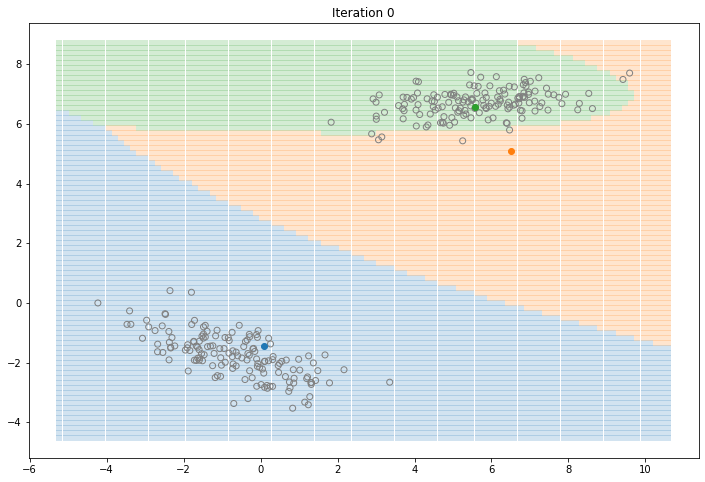

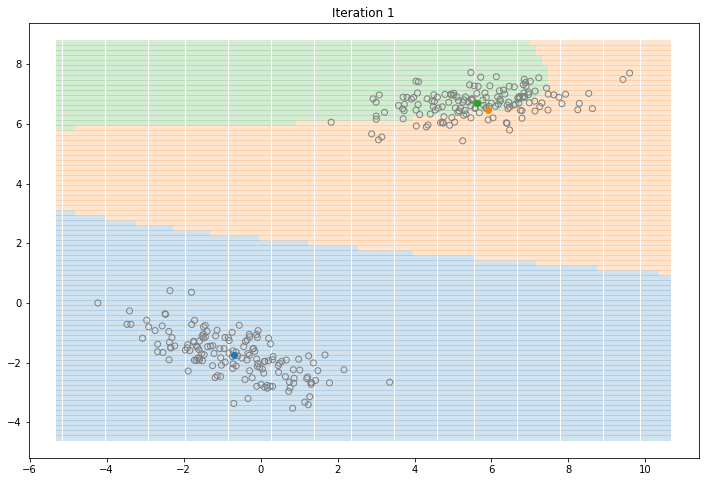

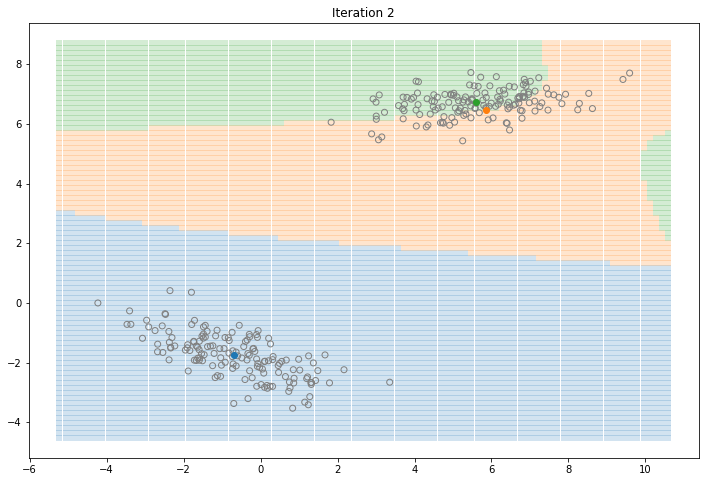

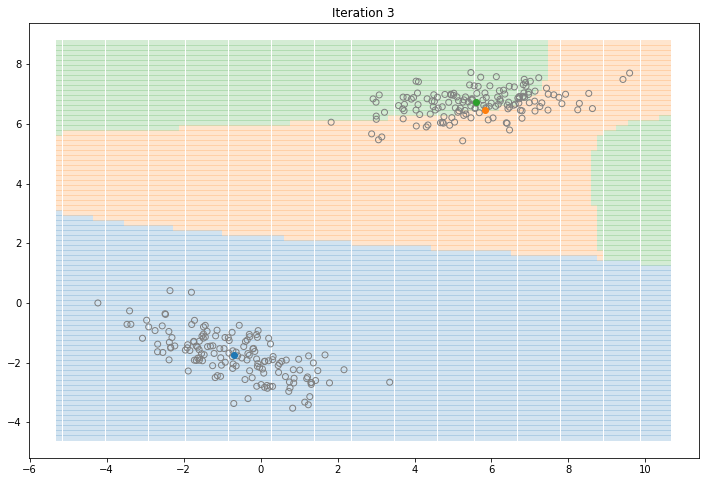

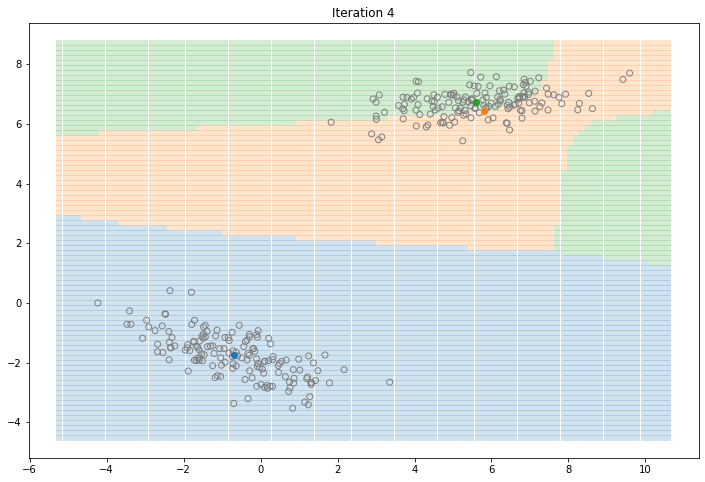

...

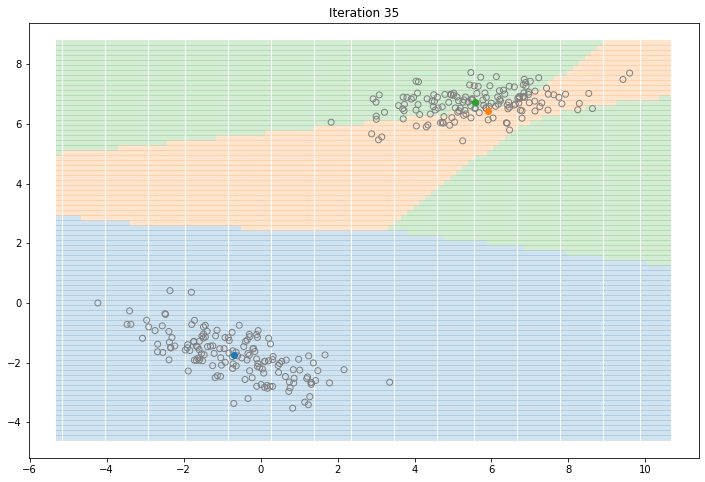

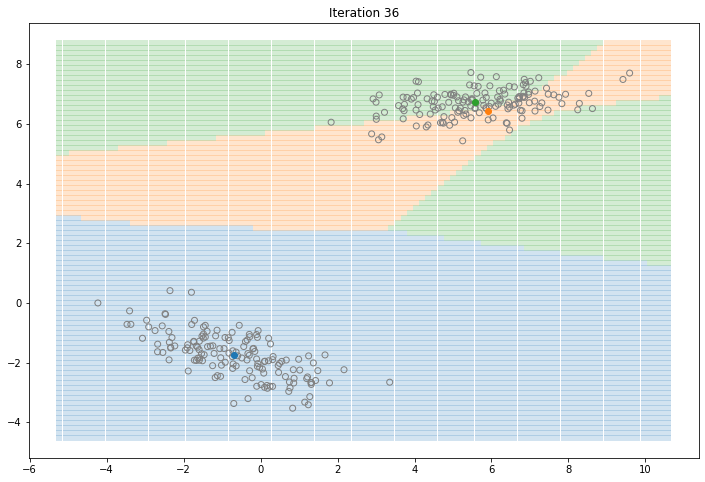

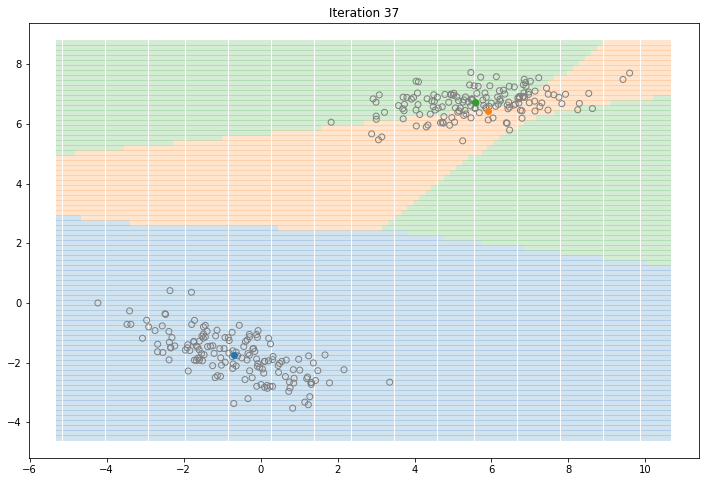

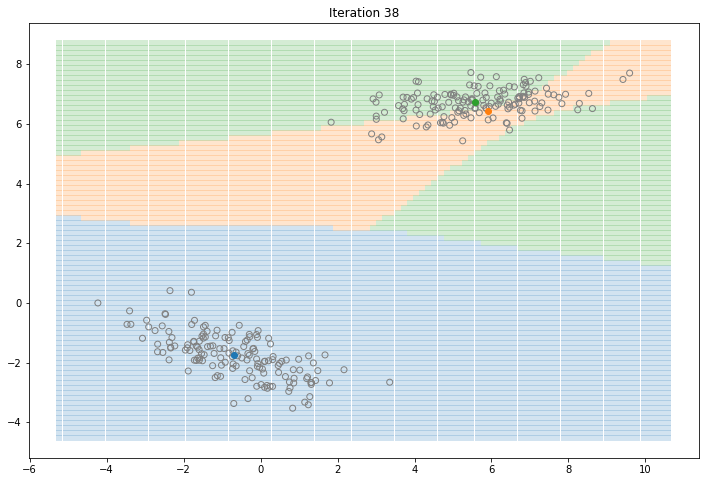

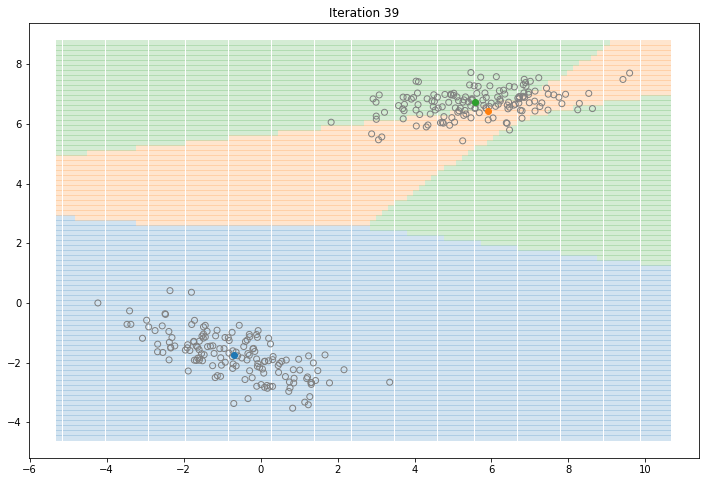

In [159]:
import matplotlib.pyplot as plt
colors = ['tab:blue', 'tab:orange', 'tab:green', 'magenta', 'yellow', 'red', 'brown', 'grey']
eps=1e-8

# run GMM for 40 steps
for step in range(40):

  # visualize the learned clusters
  if step % 1 == 0:
    plt.figure(figsize=(12,int(8)))
    plt.title("Iteration {}".format(step))
    axes = plt.gca()
    
    likelihood = []
    for j in range(k):
      likelihood.append(multivariate_normal.pdf(x=pos, mean=means[j], cov=cov[j]))
    likelihood = np.array(likelihood)
    predictions = np.argmax(likelihood, axis=0)
    
    for c in range(k):
      pred_ids = np.where(predictions == c)
      plt.scatter(pos[pred_ids[0],0], pos[pred_ids[0],1], color=colors[c], alpha=0.2, edgecolors='none', marker='s')
    
    plt.scatter(X[...,0], X[...,1], facecolors='none', edgecolors='grey')
    
    for j in range(k):
      plt.scatter(means[j][0], means[j][1], color=colors[j])

    #plt.savefig("img_{0:02d}".format(step), bbox_inches='tight')
    plt.show()

  likelihood = []
  # Expectation step
  for j in range(k):
    likelihood.append(multivariate_normal.pdf(x=X, mean=means[j], cov=cov[j]))
  likelihood = np.array(likelihood)
  assert likelihood.shape == (k, len(X))
    
  b = []
  # Maximization step 
  for j in range(k):
    # use the current values for the parameters to evaluate the posterior
    # probabilities of the data to have been generanted by each gaussian
    b.append((likelihood[j] * weights[j]) / (np.sum([likelihood[i] * weights[i] for i in range(k)], axis=0)+eps))

    # updage mean and variance
    means[j] = np.sum(b[j].reshape(len(X),1) * X, axis=0) / (np.sum(b[j]+eps))
    cov[j] = np.dot((b[j].reshape(len(X),1) * (X - means[j])).T, (X - means[j])) / (np.sum(b[j])+eps)

    # update the weights
    weights[j] = np.mean(b[j])
    
    assert cov.shape == (k, X.shape[1], X.shape[1])
    assert means.shape == (k, X.shape[1])